<a href="https://colab.research.google.com/github/naveenunited061/gan/blob/main/Diabetese_Retinopthy_(APTOS)_DCGAN_Keras_Tensorflow.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Import Modules

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

## Load the files

In [ ]:
BASE_DIR = '/content/drive/My Drive/xa_train.npy'

In [ ]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [ ]:
image_paths[:5]

['/content/drive/My Drive/xa_train.npy/EyePACS-TRAIN-NRG-1962.jpg',
 '/content/drive/My Drive/xa_train.npy/EyePACS-TRAIN-NRG-1772.jpg',
 '/content/drive/My Drive/xa_train.npy/EyePACS-TRAIN-NRG-1801.jpg',
 '/content/drive/My Drive/xa_train.npy/EyePACS-TRAIN-NRG-1777.jpg',
 '/content/drive/My Drive/xa_train.npy/EyePACS-TRAIN-NRG-18.jpg']

In [ ]:
len(image_paths)

1605

## Visualize the Image Dataset

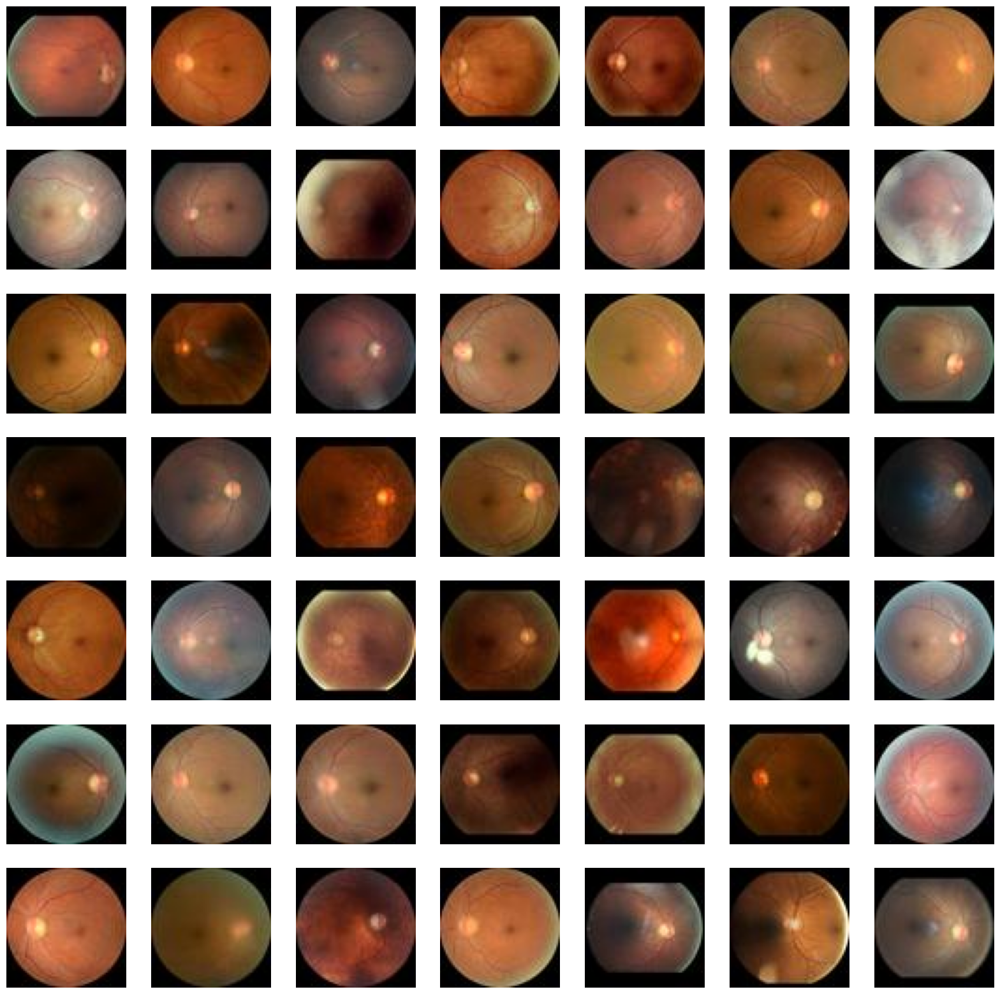

In [ ]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

## Preprocess Images

In [ ]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/1605 [00:00<?, ?it/s]

In [ ]:
train_images[0].shape

(64, 64, 3)

In [ ]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [ ]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [ ]:
train_images[0]

array([[[-1.        , -0.99215686, -0.9843137 ],
        [-1.        , -0.99215686, -0.9843137 ],
        [-1.        , -1.        , -0.9843137 ],
        ...,
        [-0.99215686, -1.        , -1.        ],
        [-0.99215686, -1.        , -1.        ],
        [-0.99215686, -1.        , -1.        ]],

       [[-1.        , -0.99215686, -0.9843137 ],
        [-1.        , -0.99215686, -0.9843137 ],
        [-1.        , -1.        , -0.9843137 ],
        ...,
        [-0.99215686, -1.        , -1.        ],
        [-0.99215686, -1.        , -1.        ],
        [-0.99215686, -1.        , -1.        ]],

       [[-1.        , -1.        , -0.9843137 ],
        [-1.        , -1.        , -0.9843137 ],
        [-1.        , -1.        , -0.9843137 ],
        ...,
        [-1.        , -0.99215686, -1.        ],
        [-0.99215686, -1.        , -1.        ],
        [-0.99215686, -1.        , -1.        ]],

       ...,

       [[-1.        , -0.9843137 , -0.9843137 ],
        [-1

## Create Generator & Discriminator Models

In [ ]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

### Generator Model

Generator Model will create new images similar to training data from random noise

In [ ]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 32768)               │       3,309,568 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu (ReLU)                         │ (None, 32768)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 16, 16, 256)         │       2,097,408 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_1 (ReLU)                       │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 32, 32, 128)         │         524,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_2 (ReLU)                       │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 64, 64, 64)          │         131,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ re_lu_3 (ReLU)                       │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 64, 64, 3)           │           3,075 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

### Discriminator Model

Discriminator model will classify the image from the generator to check whether it real (or) fake images.

In [ ]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_1 (Conv2D)                    │ (None, 32, 32, 64)          │           3,136 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 16, 16, 128)         │         131,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 8, 8, 128)           │         262,272 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │           8,193 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

## Create DCGAN

In [ ]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [ ]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [ ]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 1.7269 - g_loss: 0.3464

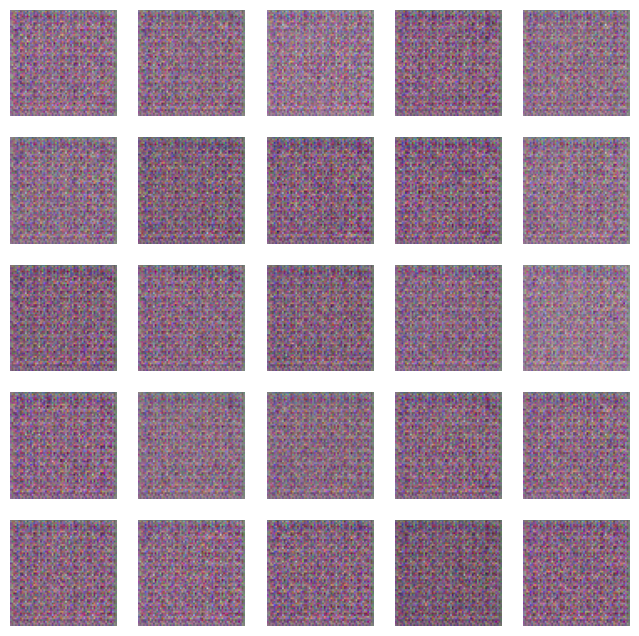

51/51 ━━━━━━━━━━━━━━━━━━━━ 244s 5s/step - d_loss: 1.7283 - g_loss: 0.3463
Epoch 2/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 1.0376 - g_loss: 1.4204

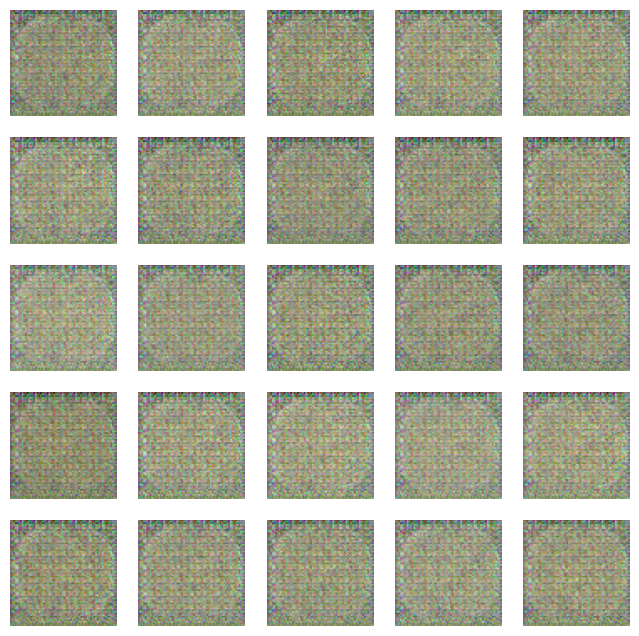

51/51 ━━━━━━━━━━━━━━━━━━━━ 250s 4s/step - d_loss: 1.0334 - g_loss: 1.4305
Epoch 3/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.3096 - g_loss: 3.0282

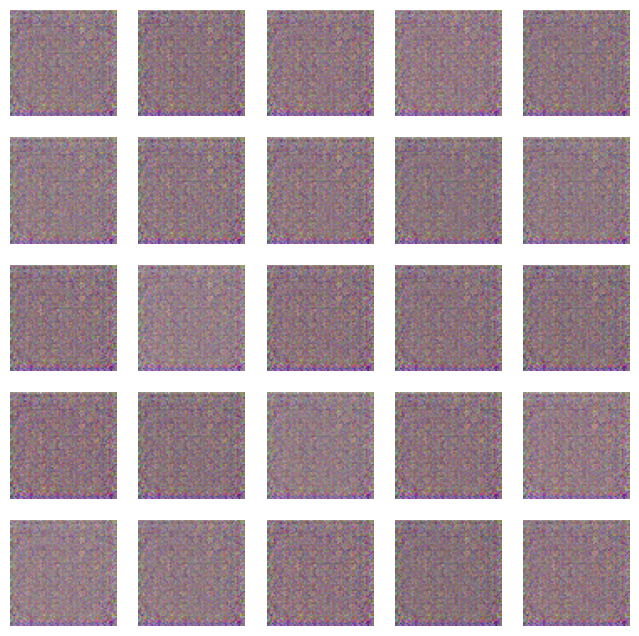

51/51 ━━━━━━━━━━━━━━━━━━━━ 227s 4s/step - d_loss: 0.3082 - g_loss: 3.0308
Epoch 4/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.0865 - g_loss: 3.4931

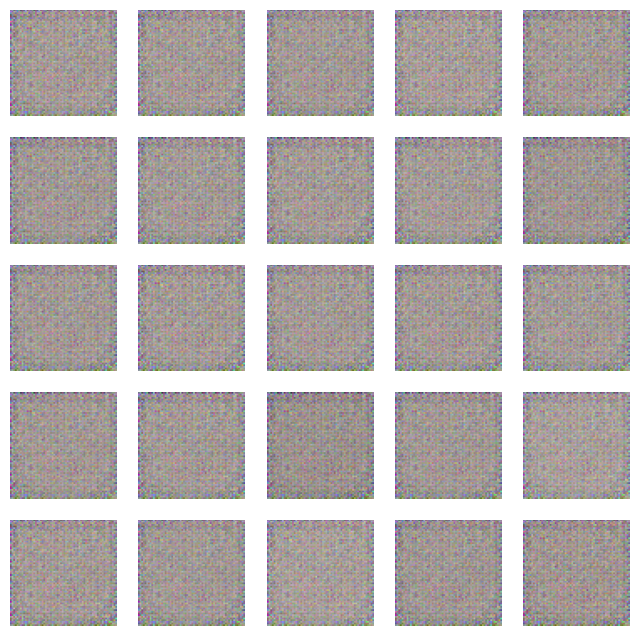

51/51 ━━━━━━━━━━━━━━━━━━━━ 228s 4s/step - d_loss: 0.0863 - g_loss: 3.4945
Epoch 5/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.0667 - g_loss: 3.7374

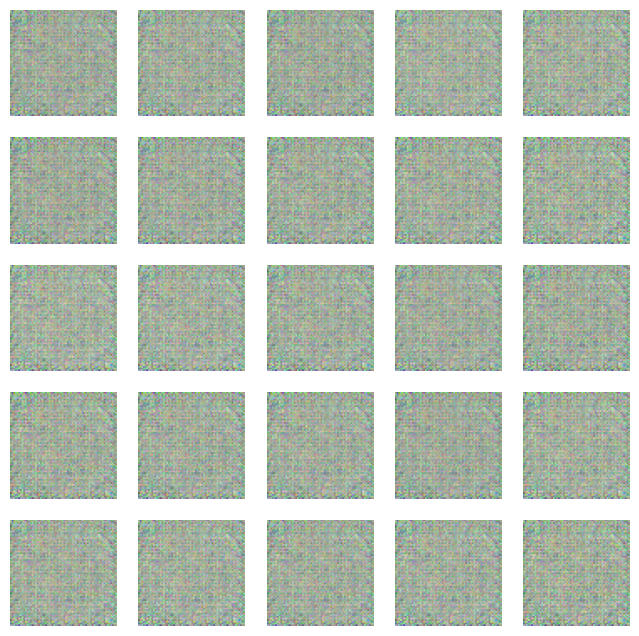

51/51 ━━━━━━━━━━━━━━━━━━━━ 262s 4s/step - d_loss: 0.0662 - g_loss: 3.7361
Epoch 6/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: -0.0328 - g_loss: 3.6903

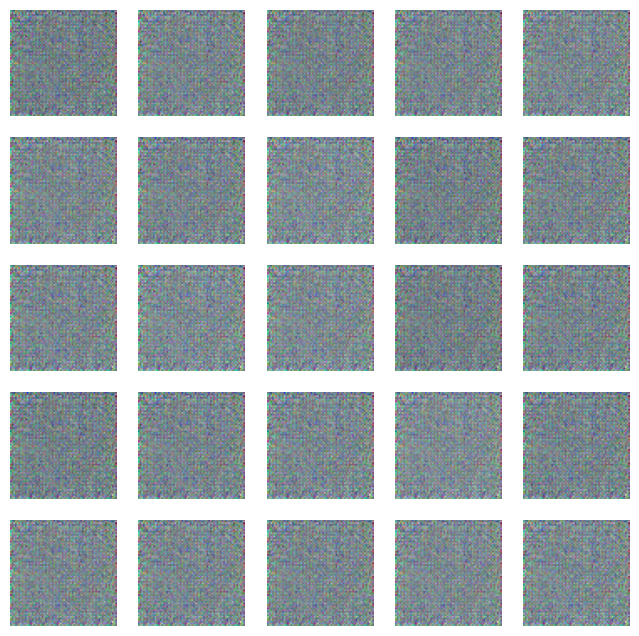

51/51 ━━━━━━━━━━━━━━━━━━━━ 228s 4s/step - d_loss: -0.0333 - g_loss: 3.6923
Epoch 7/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: -0.1278 - g_loss: 4.1165

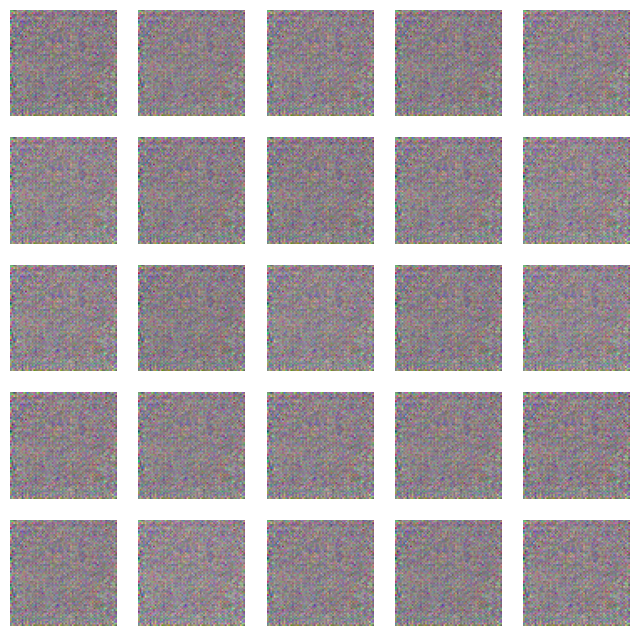

51/51 ━━━━━━━━━━━━━━━━━━━━ 262s 4s/step - d_loss: -0.1280 - g_loss: 4.1155
Epoch 8/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: -0.1674 - g_loss: 4.1831

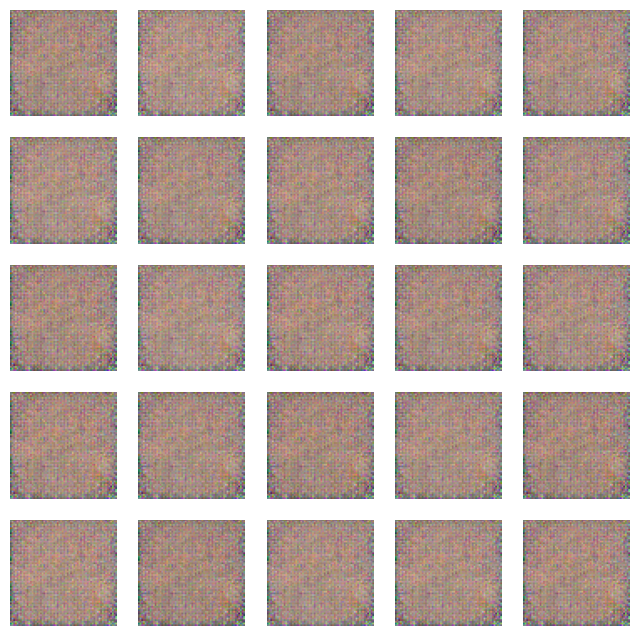

51/51 ━━━━━━━━━━━━━━━━━━━━ 228s 4s/step - d_loss: -0.1672 - g_loss: 4.1876
Epoch 9/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: -0.1432 - g_loss: 4.7283

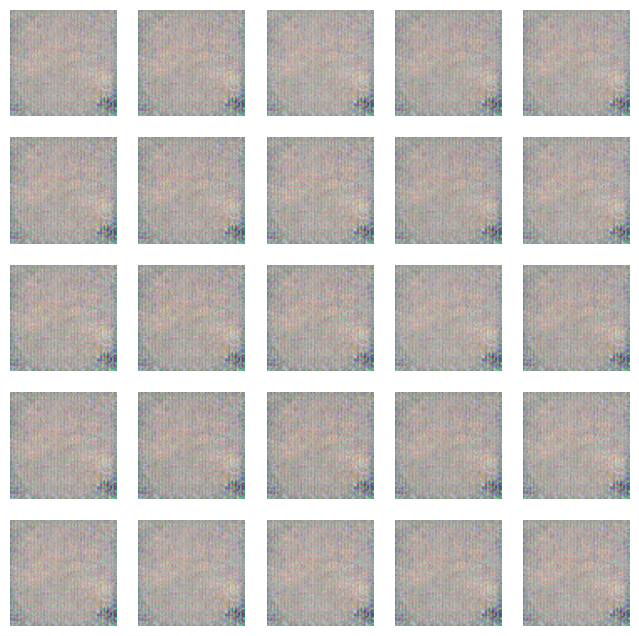

51/51 ━━━━━━━━━━━━━━━━━━━━ 262s 4s/step - d_loss: -0.1434 - g_loss: 4.7279
Epoch 10/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: -0.1315 - g_loss: 5.1023

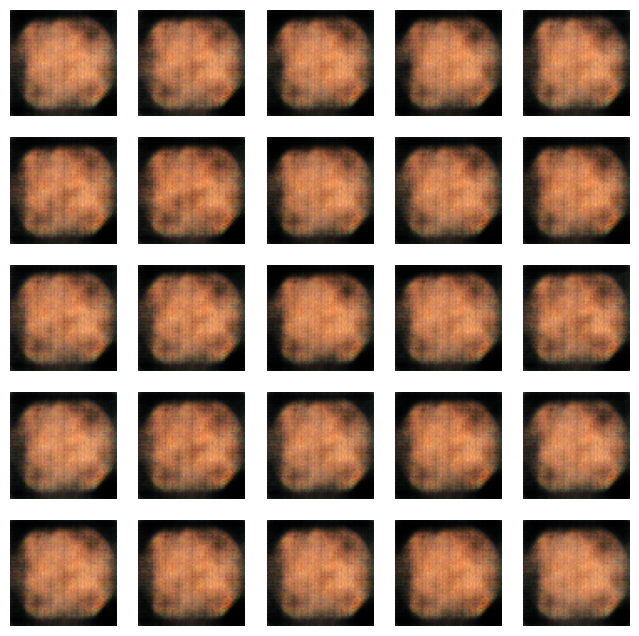

51/51 ━━━━━━━━━━━━━━━━━━━━ 261s 4s/step - d_loss: -0.1272 - g_loss: 5.1070
Epoch 11/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.2761 - g_loss: 3.2301

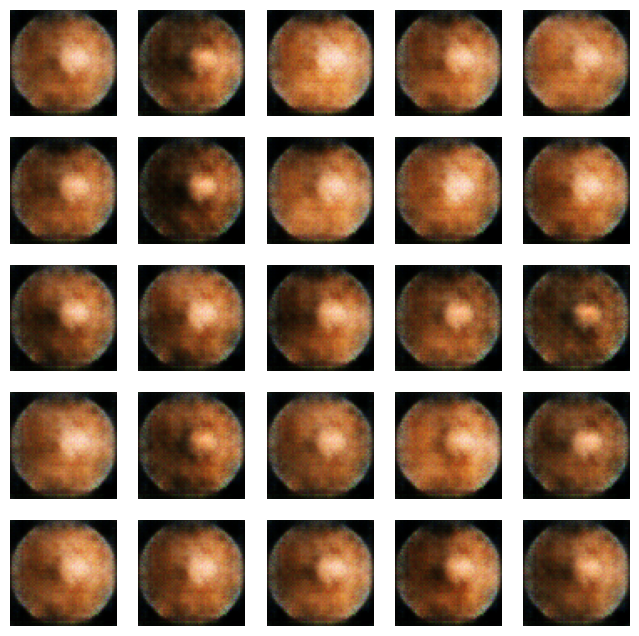

51/51 ━━━━━━━━━━━━━━━━━━━━ 263s 4s/step - d_loss: 0.2760 - g_loss: 3.2298
Epoch 12/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.6401 - g_loss: 2.2757

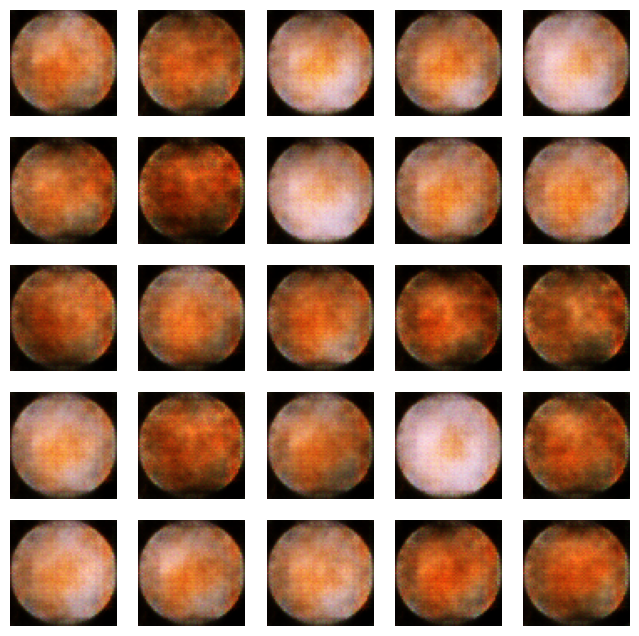

51/51 ━━━━━━━━━━━━━━━━━━━━ 261s 4s/step - d_loss: 0.6396 - g_loss: 2.2694
Epoch 13/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.4982 - g_loss: 1.9311

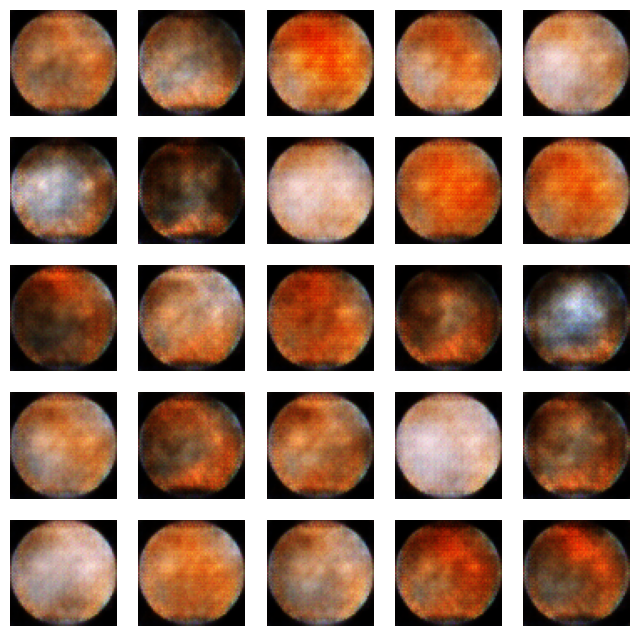

51/51 ━━━━━━━━━━━━━━━━━━━━ 263s 5s/step - d_loss: 0.4986 - g_loss: 1.9286
Epoch 14/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.8257 - g_loss: 1.3497

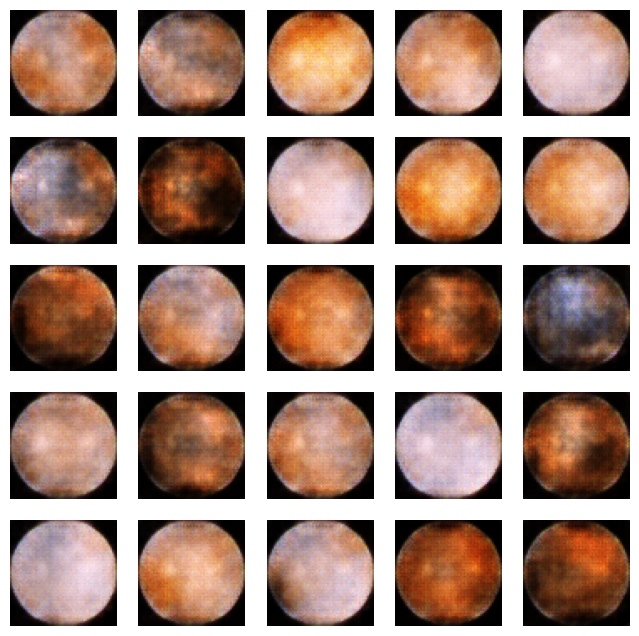

51/51 ━━━━━━━━━━━━━━━━━━━━ 263s 5s/step - d_loss: 0.8237 - g_loss: 1.3495
Epoch 15/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.6659 - g_loss: 1.2689

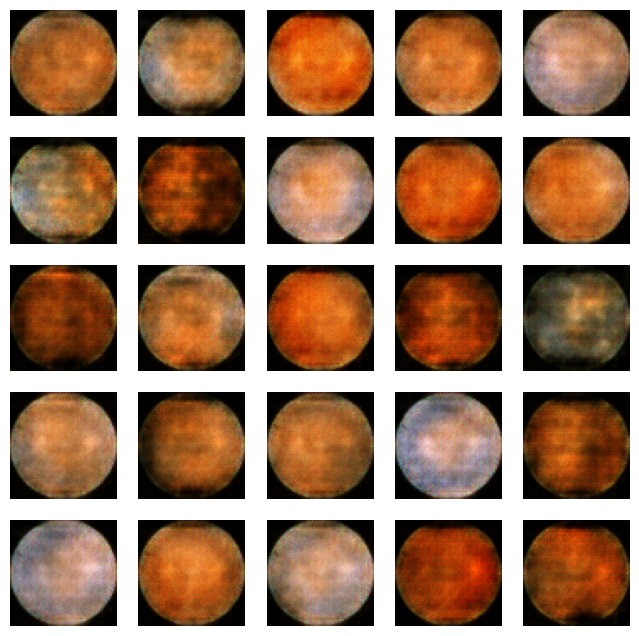

51/51 ━━━━━━━━━━━━━━━━━━━━ 260s 5s/step - d_loss: 0.6651 - g_loss: 1.2680
Epoch 16/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.6800 - g_loss: 1.2679

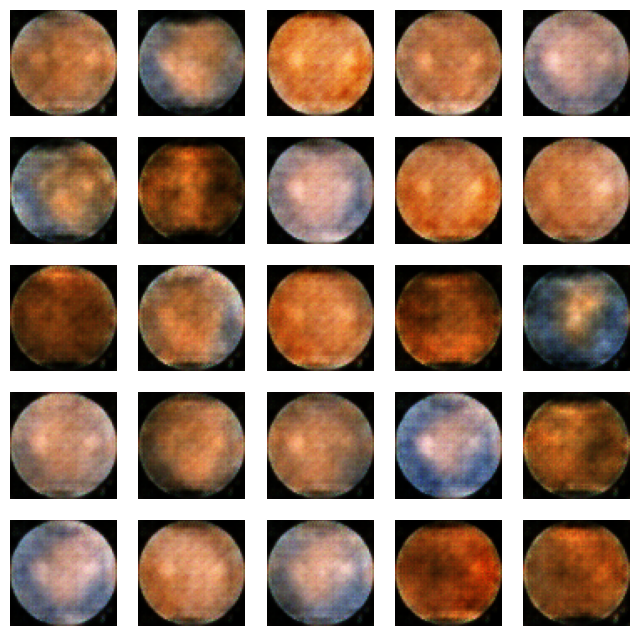

51/51 ━━━━━━━━━━━━━━━━━━━━ 263s 5s/step - d_loss: 0.6796 - g_loss: 1.2664
Epoch 17/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.6293 - g_loss: 1.3264

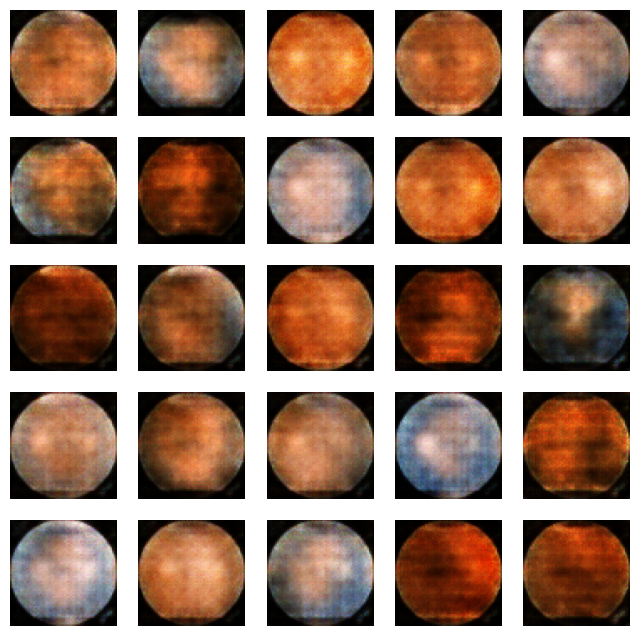

51/51 ━━━━━━━━━━━━━━━━━━━━ 261s 5s/step - d_loss: 0.6288 - g_loss: 1.3258
Epoch 18/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.6909 - g_loss: 1.3144

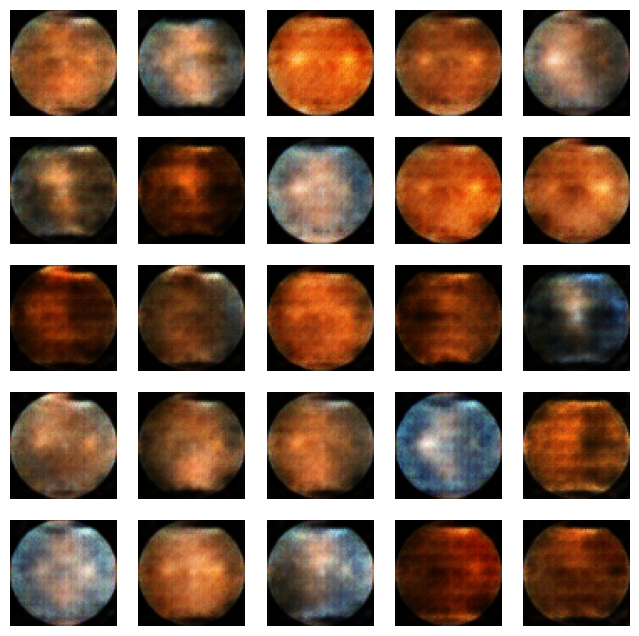

51/51 ━━━━━━━━━━━━━━━━━━━━ 262s 5s/step - d_loss: 0.6896 - g_loss: 1.3140
Epoch 19/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.5795 - g_loss: 1.4375

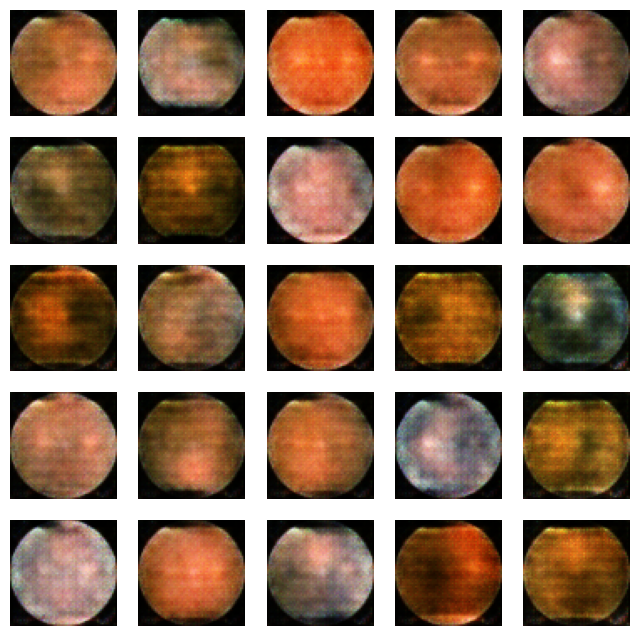

51/51 ━━━━━━━━━━━━━━━━━━━━ 233s 5s/step - d_loss: 0.5800 - g_loss: 1.4371
Epoch 20/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6638 - g_loss: 1.3650

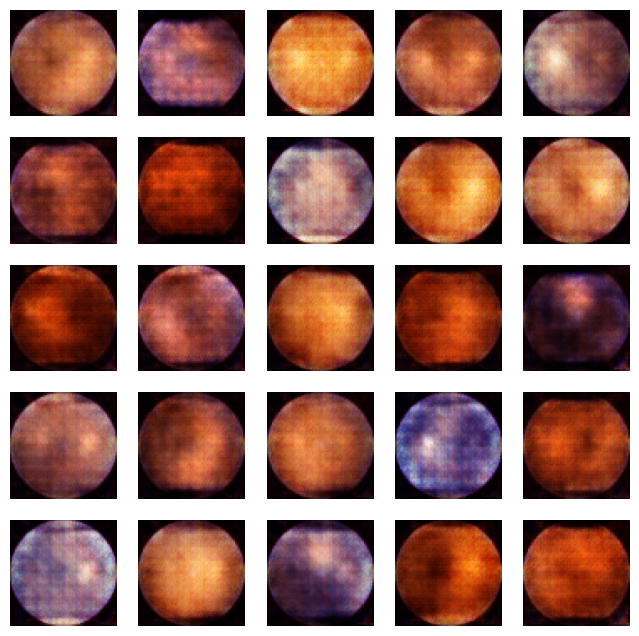

51/51 ━━━━━━━━━━━━━━━━━━━━ 232s 5s/step - d_loss: 0.6630 - g_loss: 1.3653
Epoch 21/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.6328 - g_loss: 1.3211

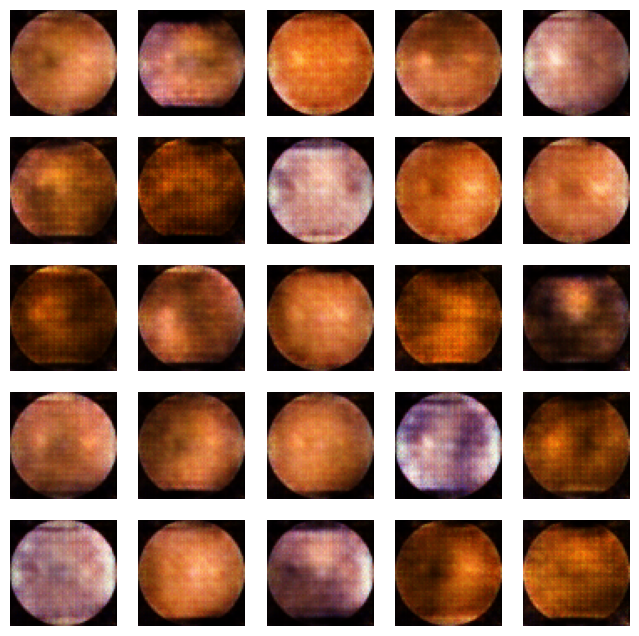

51/51 ━━━━━━━━━━━━━━━━━━━━ 262s 5s/step - d_loss: 0.6330 - g_loss: 1.3210
Epoch 22/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 4s/step - d_loss: 0.6650 - g_loss: 1.3787

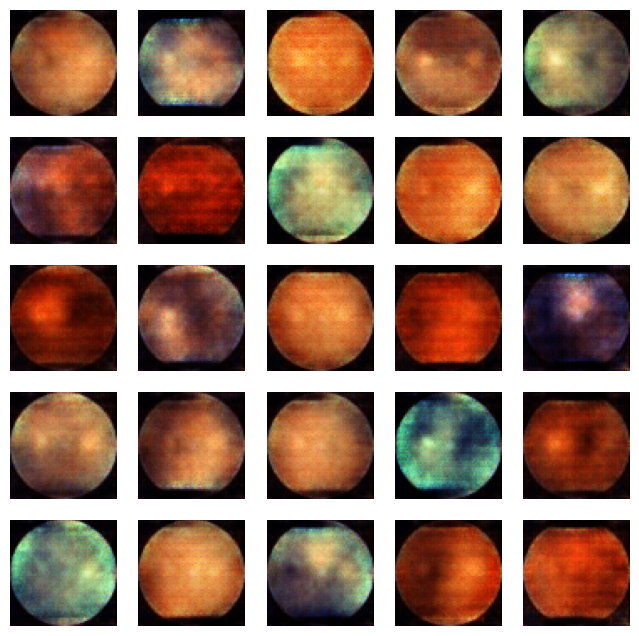

51/51 ━━━━━━━━━━━━━━━━━━━━ 263s 5s/step - d_loss: 0.6646 - g_loss: 1.3777
Epoch 23/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7173 - g_loss: 1.3143

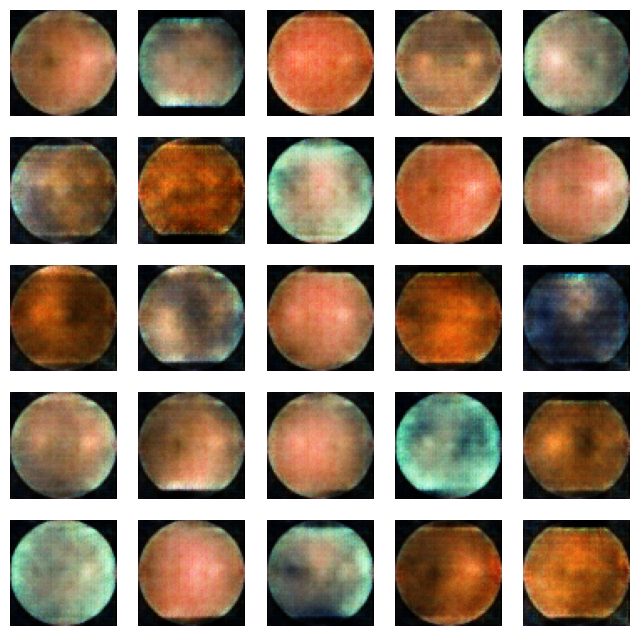

51/51 ━━━━━━━━━━━━━━━━━━━━ 261s 5s/step - d_loss: 0.7163 - g_loss: 1.3122
Epoch 24/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6319 - g_loss: 1.1664

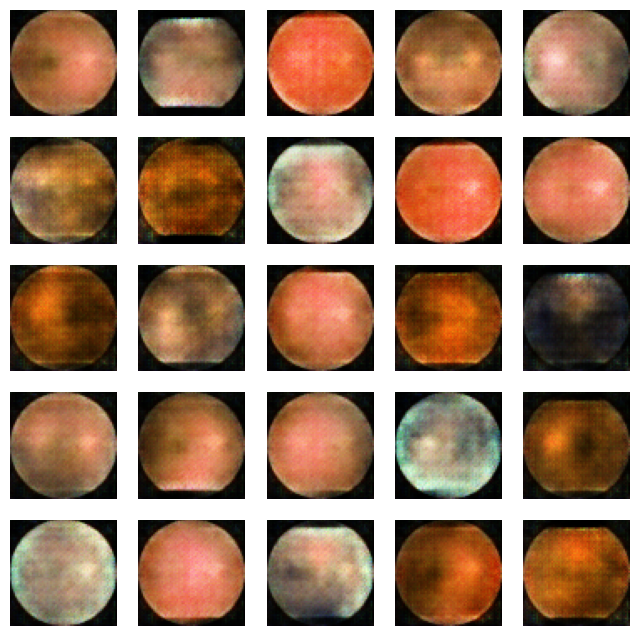

51/51 ━━━━━━━━━━━━━━━━━━━━ 261s 5s/step - d_loss: 0.6318 - g_loss: 1.1663
Epoch 25/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6984 - g_loss: 1.2242

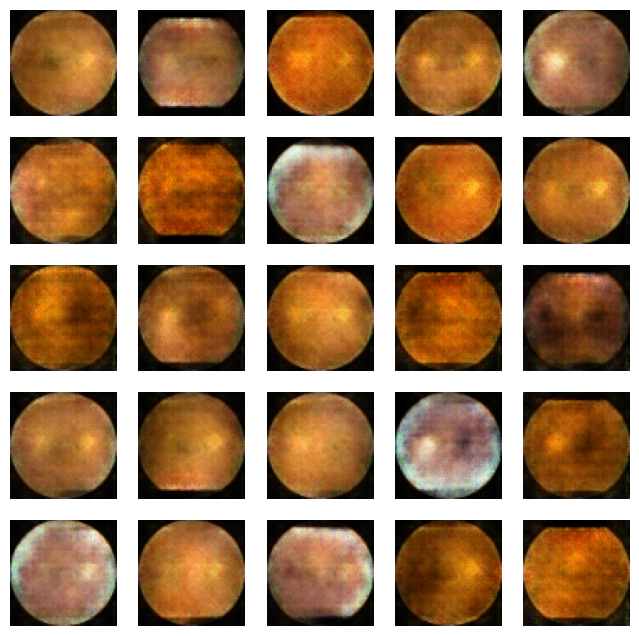

51/51 ━━━━━━━━━━━━━━━━━━━━ 263s 5s/step - d_loss: 0.6978 - g_loss: 1.2229
Epoch 26/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6189 - g_loss: 1.2893

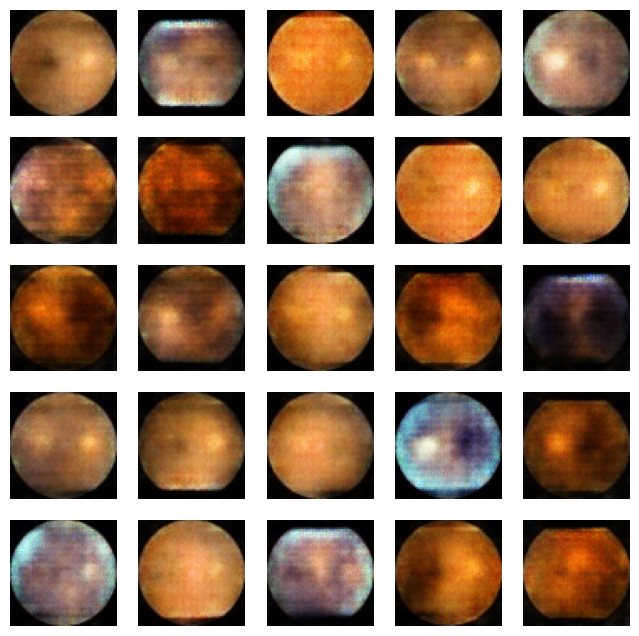

51/51 ━━━━━━━━━━━━━━━━━━━━ 262s 5s/step - d_loss: 0.6189 - g_loss: 1.2876
Epoch 27/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6797 - g_loss: 1.2746

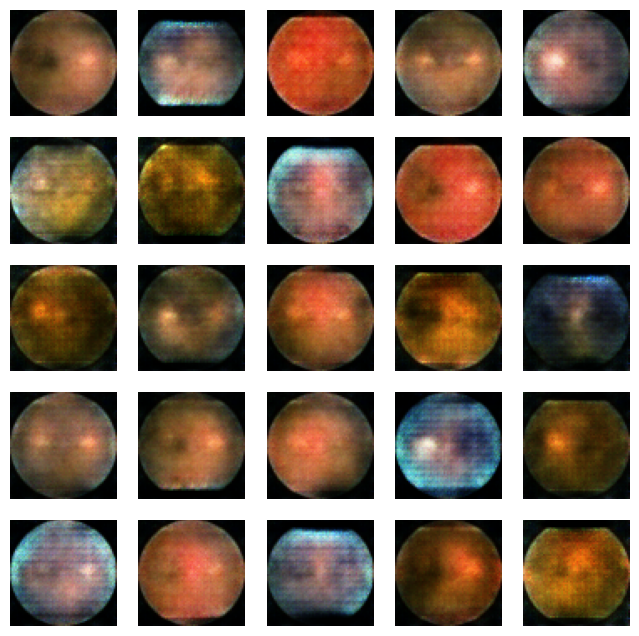

51/51 ━━━━━━━━━━━━━━━━━━━━ 234s 5s/step - d_loss: 0.6792 - g_loss: 1.2732
Epoch 28/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6436 - g_loss: 1.1662

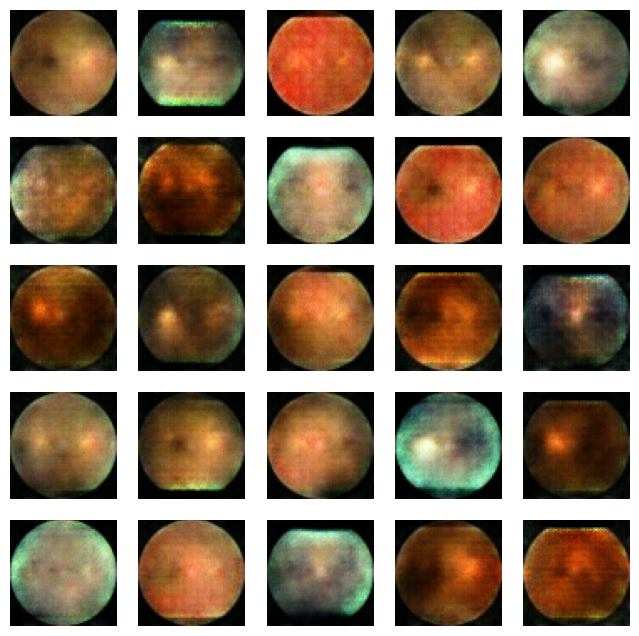

51/51 ━━━━━━━━━━━━━━━━━━━━ 262s 5s/step - d_loss: 0.6437 - g_loss: 1.1655
Epoch 29/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6846 - g_loss: 1.1091

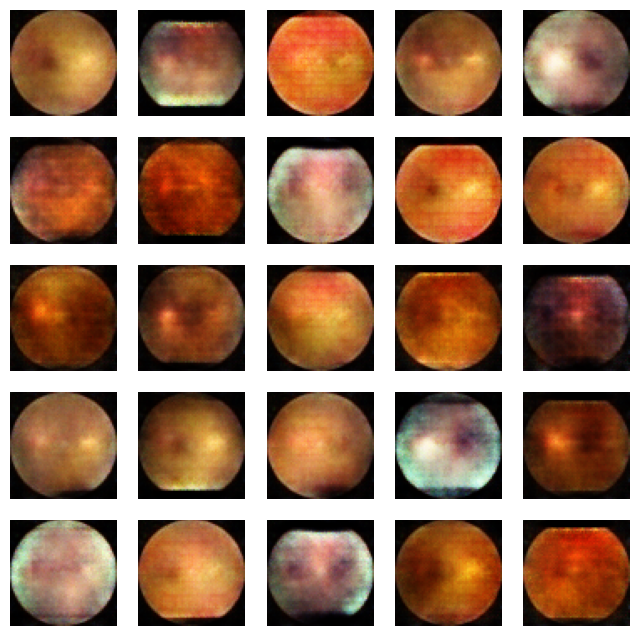

51/51 ━━━━━━━━━━━━━━━━━━━━ 261s 5s/step - d_loss: 0.6842 - g_loss: 1.1083
Epoch 30/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6428 - g_loss: 1.0628

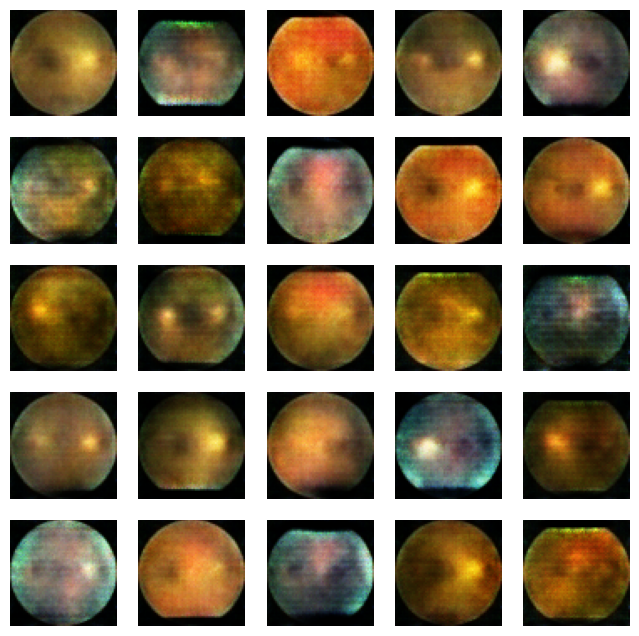

51/51 ━━━━━━━━━━━━━━━━━━━━ 235s 5s/step - d_loss: 0.6430 - g_loss: 1.0627
Epoch 31/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6894 - g_loss: 0.9500

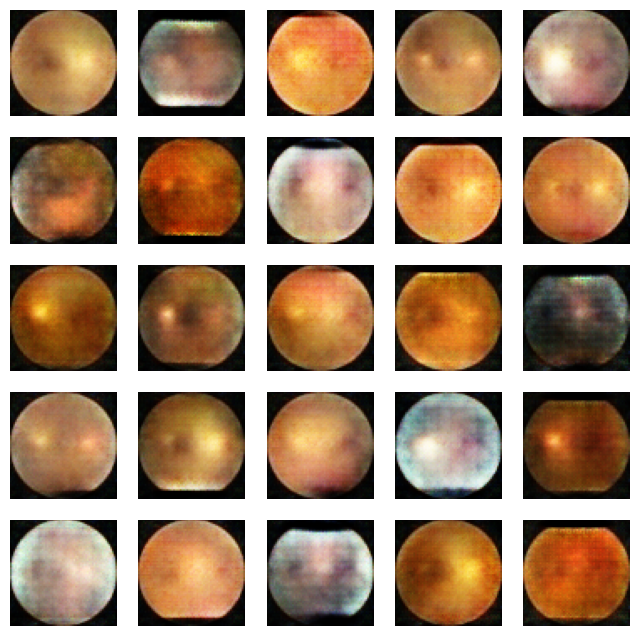

51/51 ━━━━━━━━━━━━━━━━━━━━ 260s 5s/step - d_loss: 0.6896 - g_loss: 0.9502
Epoch 32/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6989 - g_loss: 0.9999

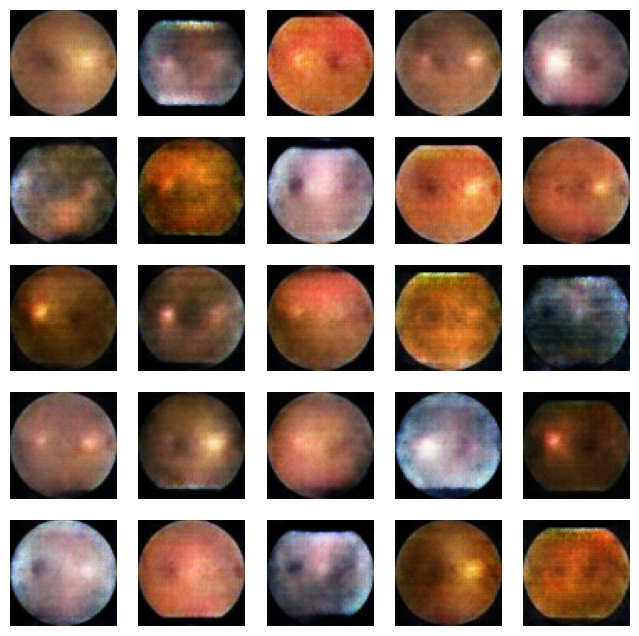

51/51 ━━━━━━━━━━━━━━━━━━━━ 237s 5s/step - d_loss: 0.6990 - g_loss: 0.9997
Epoch 33/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6846 - g_loss: 1.0443

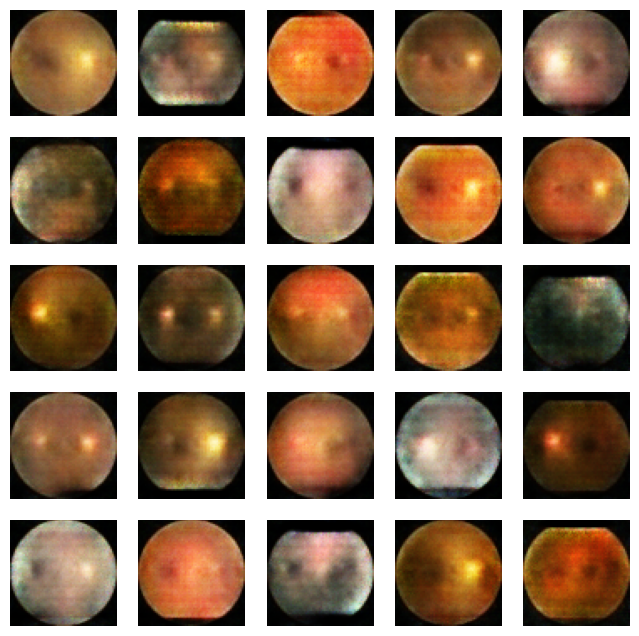

51/51 ━━━━━━━━━━━━━━━━━━━━ 234s 5s/step - d_loss: 0.6846 - g_loss: 1.0434
Epoch 34/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7207 - g_loss: 1.0172

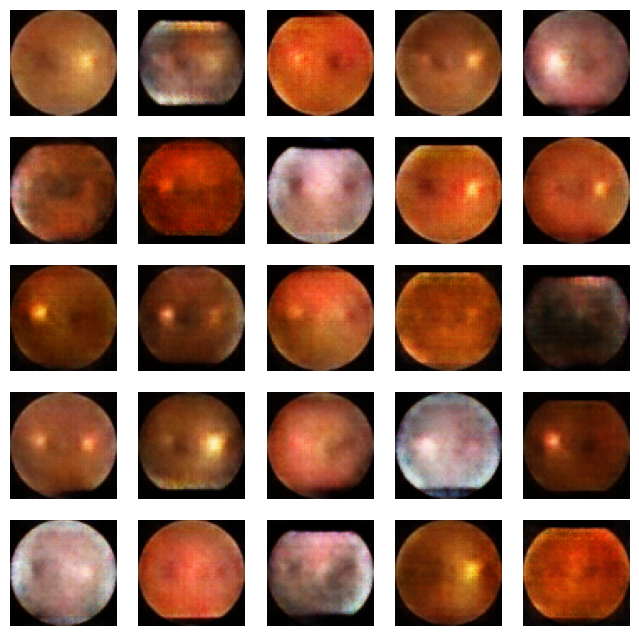

51/51 ━━━━━━━━━━━━━━━━━━━━ 263s 5s/step - d_loss: 0.7204 - g_loss: 1.0165
Epoch 35/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6844 - g_loss: 1.0549

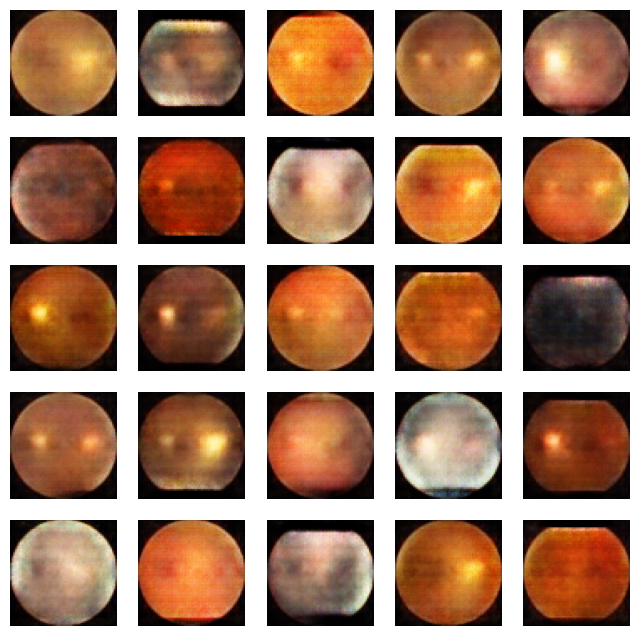

51/51 ━━━━━━━━━━━━━━━━━━━━ 238s 5s/step - d_loss: 0.6846 - g_loss: 1.0540
Epoch 36/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7009 - g_loss: 1.0198

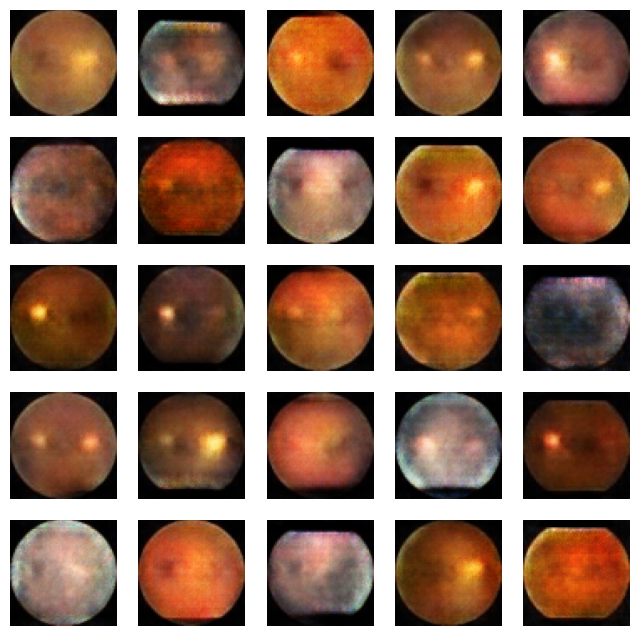

51/51 ━━━━━━━━━━━━━━━━━━━━ 235s 5s/step - d_loss: 0.7014 - g_loss: 1.0177
Epoch 37/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7375 - g_loss: 0.9160

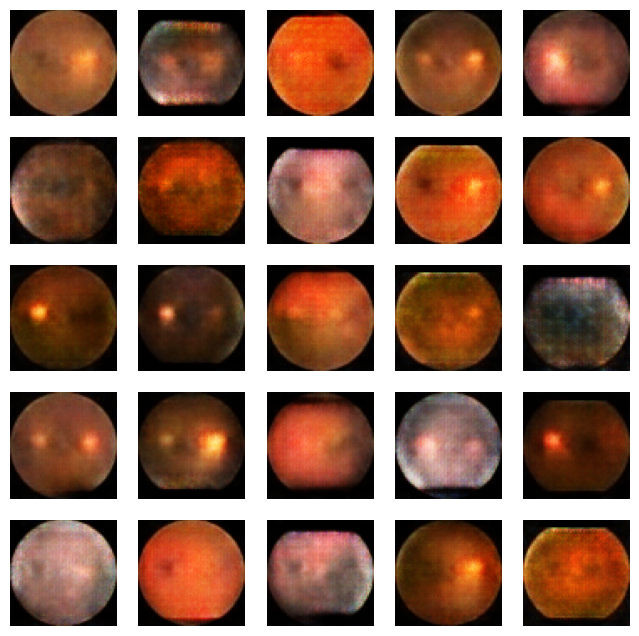

51/51 ━━━━━━━━━━━━━━━━━━━━ 264s 5s/step - d_loss: 0.7376 - g_loss: 0.9153
Epoch 38/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7676 - g_loss: 0.8935

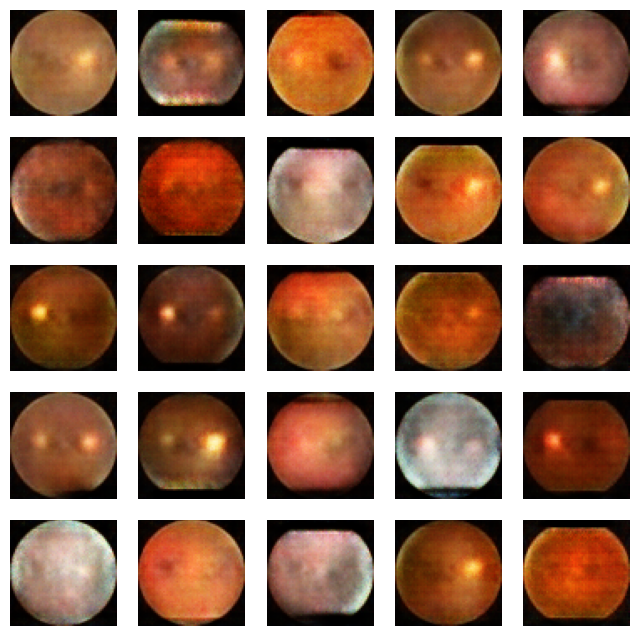

51/51 ━━━━━━━━━━━━━━━━━━━━ 262s 5s/step - d_loss: 0.7672 - g_loss: 0.8928
Epoch 39/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7725 - g_loss: 0.8985

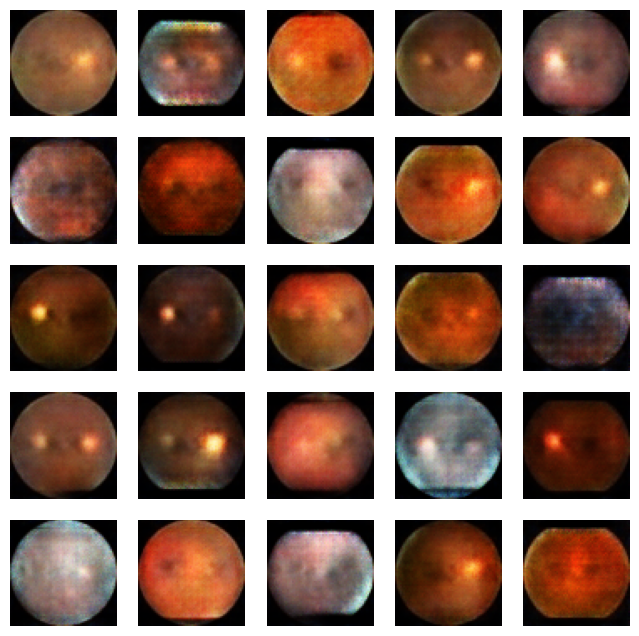

51/51 ━━━━━━━━━━━━━━━━━━━━ 240s 5s/step - d_loss: 0.7719 - g_loss: 0.8980
Epoch 40/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7127 - g_loss: 0.9098

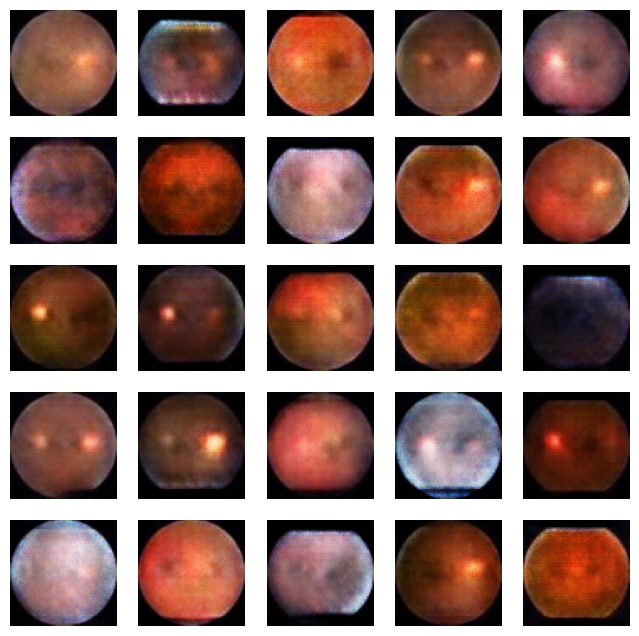

51/51 ━━━━━━━━━━━━━━━━━━━━ 263s 5s/step - d_loss: 0.7125 - g_loss: 0.9092
Epoch 41/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7530 - g_loss: 0.9131

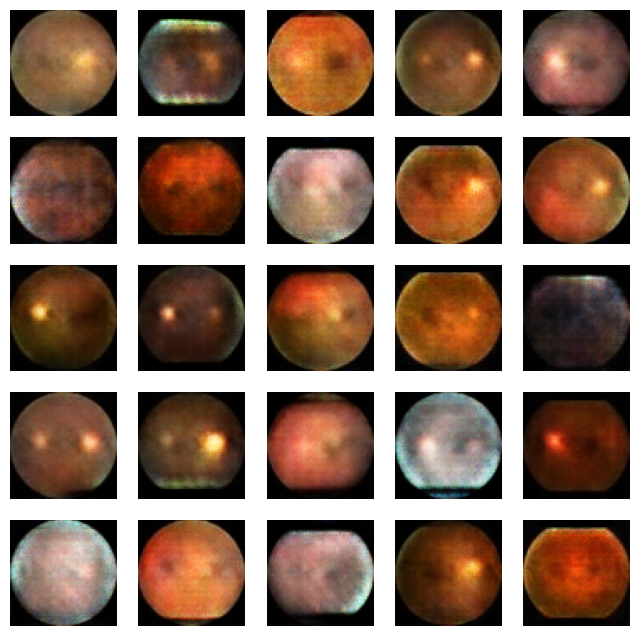

51/51 ━━━━━━━━━━━━━━━━━━━━ 261s 5s/step - d_loss: 0.7527 - g_loss: 0.9125
Epoch 42/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7998 - g_loss: 0.8459

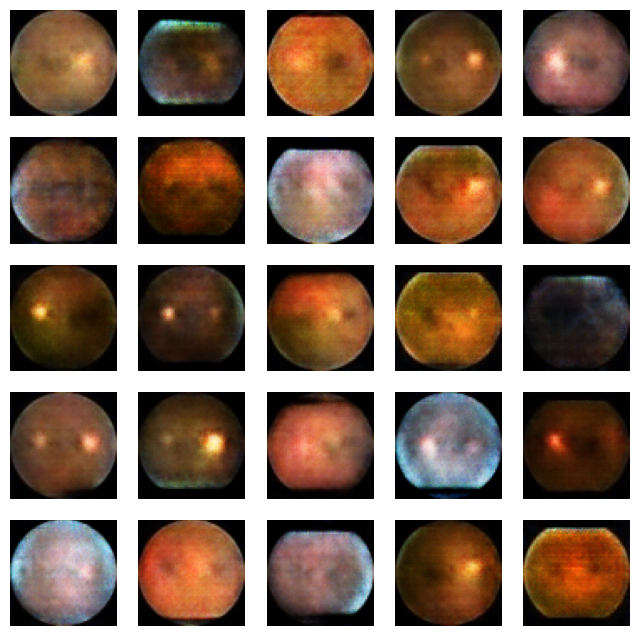

51/51 ━━━━━━━━━━━━━━━━━━━━ 265s 5s/step - d_loss: 0.7987 - g_loss: 0.8460
Epoch 43/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7362 - g_loss: 0.8470

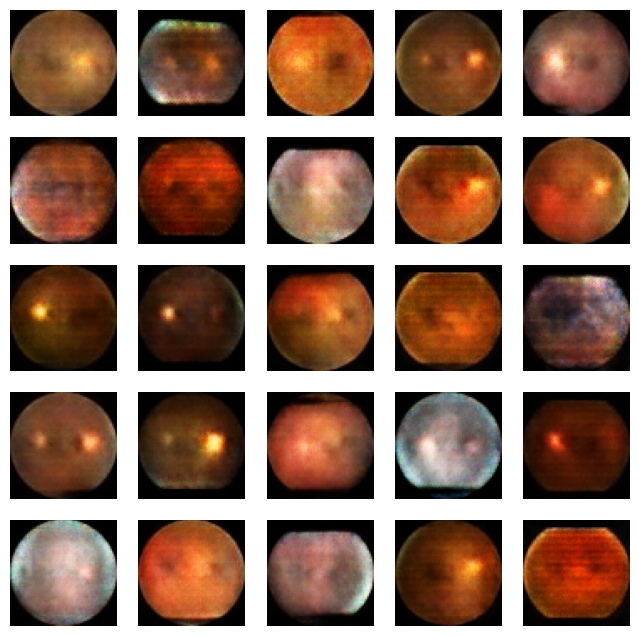

51/51 ━━━━━━━━━━━━━━━━━━━━ 260s 5s/step - d_loss: 0.7361 - g_loss: 0.8469
Epoch 44/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7162 - g_loss: 0.8529

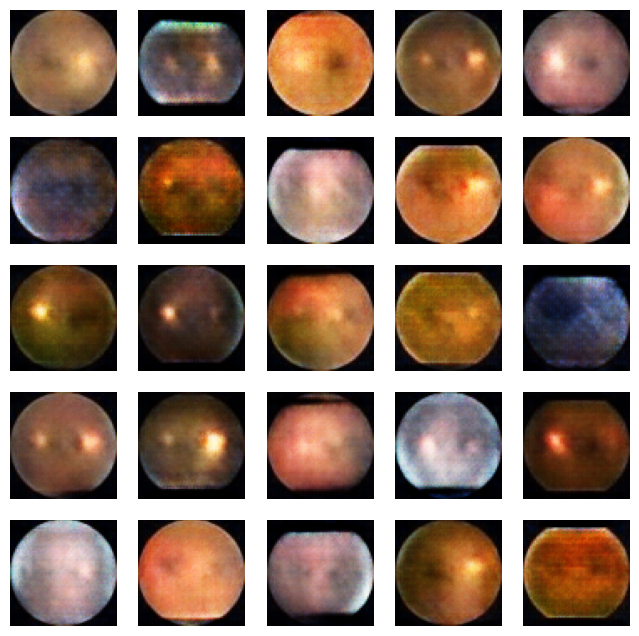

51/51 ━━━━━━━━━━━━━━━━━━━━ 243s 5s/step - d_loss: 0.7158 - g_loss: 0.8532
Epoch 45/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.6859 - g_loss: 0.8917

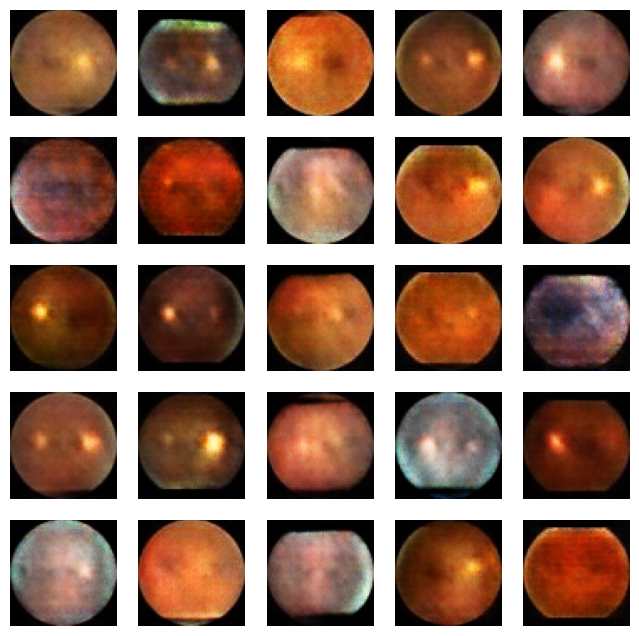

51/51 ━━━━━━━━━━━━━━━━━━━━ 260s 5s/step - d_loss: 0.6861 - g_loss: 0.8912
Epoch 46/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7465 - g_loss: 0.8149

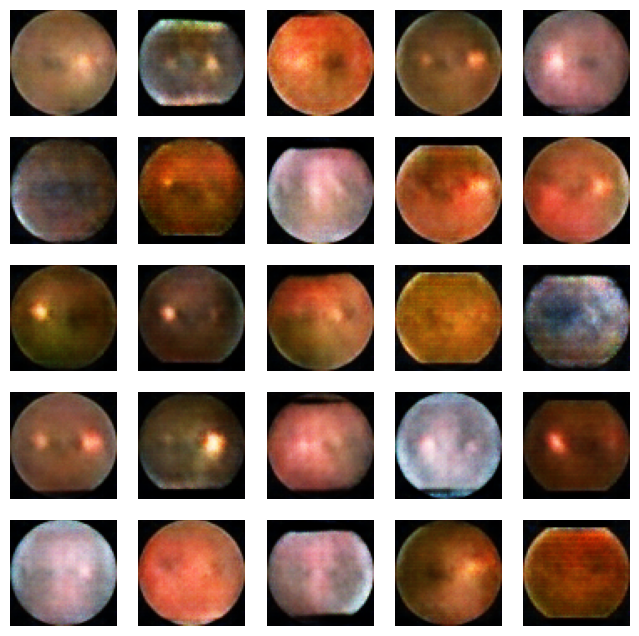

51/51 ━━━━━━━━━━━━━━━━━━━━ 265s 5s/step - d_loss: 0.7460 - g_loss: 0.8153
Epoch 47/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7518 - g_loss: 0.8589

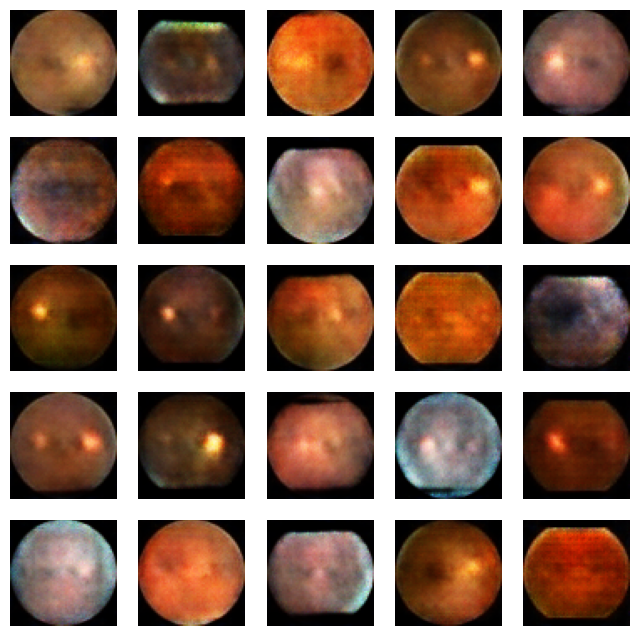

51/51 ━━━━━━━━━━━━━━━━━━━━ 241s 5s/step - d_loss: 0.7510 - g_loss: 0.8587
Epoch 48/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7235 - g_loss: 0.8857

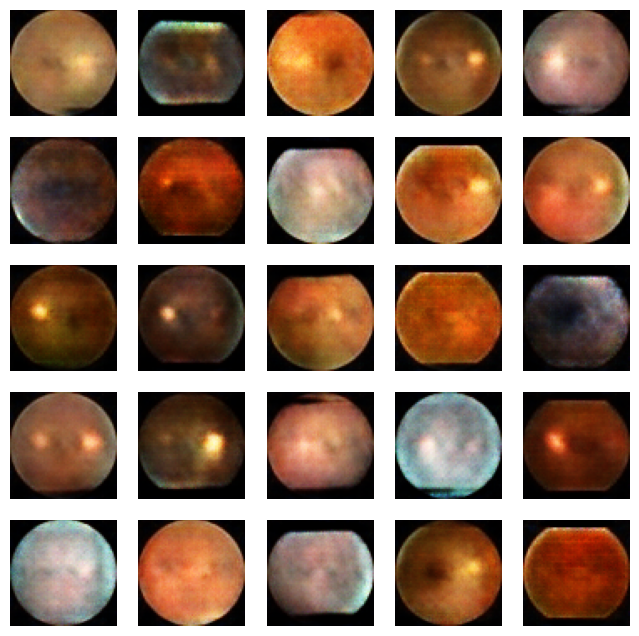

51/51 ━━━━━━━━━━━━━━━━━━━━ 244s 5s/step - d_loss: 0.7232 - g_loss: 0.8854
Epoch 49/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7049 - g_loss: 0.8678

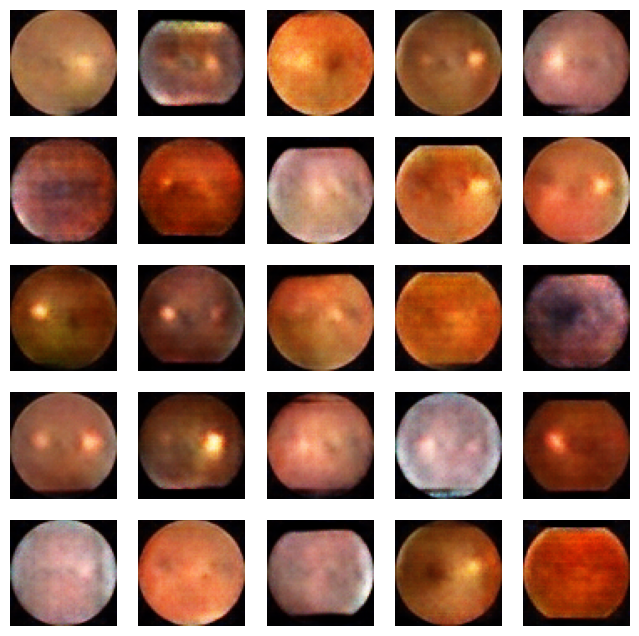

51/51 ━━━━━━━━━━━━━━━━━━━━ 243s 5s/step - d_loss: 0.7048 - g_loss: 0.8674
Epoch 50/50
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 5s/step - d_loss: 0.7313 - g_loss: 0.8848

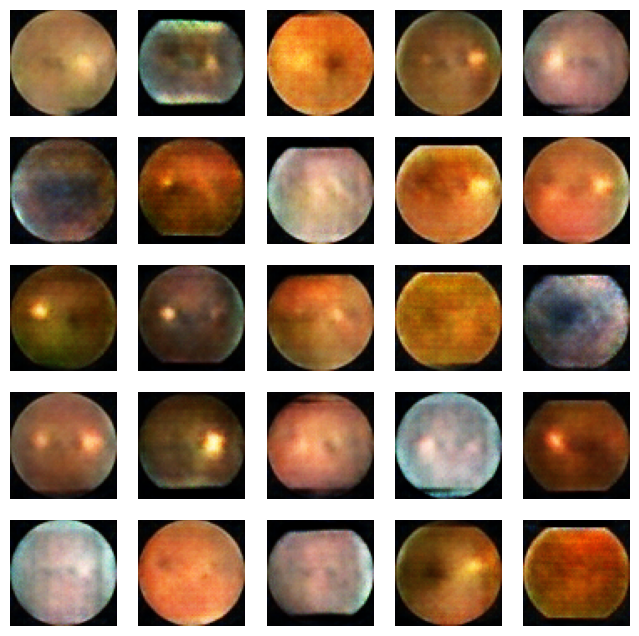

51/51 ━━━━━━━━━━━━━━━━━━━━ 261s 5s/step - d_loss: 0.7309 - g_loss: 0.8843


In [ ]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])


## Generate New Diabetese Retinopathy Image



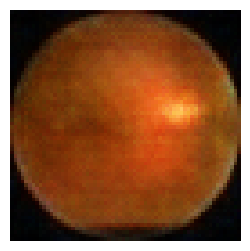

In [ ]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()

In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import array_to_img
import os
import random

# Define the directory to save generated images
save_path = '/content/drive/My Drive/generated_images'  # Change to your desired location

# Create the directory if it doesn't exist
if not os.path.exists(save_path):
    os.makedirs(save_path)

# Generate 2930 images and save them to the drive location
for i in range(2930):
    # Generate random noise
    noise = tf.random.normal([1, 100])

    # Generate an image using the generator
    g_img = dcgan.generator(noise, training=False)

    # Denormalize the image (assuming pixel values were in the range [-1, 1])
    g_img = (g_img * 127.5) + 127.5

    # Convert to an image format
    img = array_to_img(g_img[0])

    # Save the image to the specified location
    img.save(os.path.join(save_path, f'image_{i+1:03d}.png'))

print("All 2930 images have been generated and saved successfully!")

# Display 15 randomly selected images from the 100 generated images
fig, axes = plt.subplots(3, 5, figsize=(15, 9))  # 3x5 grid

# Get 15 random image file names
image_files = random.sample(os.listdir(save_path), 15)

# Load and display the selected images
for i, ax in enumerate(axes.flat):
    img = plt.imread(os.path.join(save_path, image_files[i]))
    ax.imshow(img)
    ax.axis('off')

plt.tight_layout()
plt.show()